In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


In [4]:
df =pd.read_csv('/content/Dataset .csv')

In [5]:
df.head()

,Restaurant ID,Restaurant Name,Country Code,City,Address,Locality,Locality Verbose,Longitude,Latitude,Cuisines,...,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
0,6317637,Le Petit Souffle,162,Makati City,"Third Floor, Century City Mall, Kalayaan Avenu...","Century City Mall, Poblacion, Makati City","Century City Mall, Poblacion, Makati City, Mak...",121.027535,14.565443,"French, Japanese, Desserts",...,Botswana Pula(P),Yes,No,No,No,3,4.8,Dark Green,Excellent,314
1,6304287,Izakaya Kikufuji,162,Makati City,"Little Tokyo, 2277 Chino Roces Avenue, Legaspi...","Little Tokyo, Legaspi Village, Makati City","Little Tokyo, Legaspi Village, Makati City, Ma...",121.014101,14.553708,Japanese,...,Botswana Pula(P),Yes,No,No,No,3,4.5,Dark Green,Excellent,591
2,6300002,Heat - Edsa Shangri-La,162,Mandaluyong City,"Edsa Shangri-La, 1 Garden Way, Ortigas, Mandal...","Edsa Shangri-La, Ortigas, Mandaluyong City","Edsa Shangri-La, Ortigas, Mandaluyong City, Ma...",121.056831,14.581404,"Seafood, Asian, Filipino, Indian",...,Botswana Pula(P),Yes,No,No,No,4,4.4,Green,Very Good,270
3,6318506,Ooma,162,Mandaluyong City,"Third Floor, Mega Fashion Hall, SM Megamall, O...","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandal...",121.056475,14.585318,"Japanese, Sushi",...,Botswana Pula(P),No,No,No,No,4,4.9,Dark Green,Excellent,365
4,6314302,Sambo Kojin,162,Mandaluyong City,"Third Floor, Mega Atrium, SM Megamall, Ortigas...","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandal...",121.057508,14.584450,"Japanese, Korean",...,Botswana Pula(P),Yes,No,No,No,4,4.8,Dark Green,Excellent,229


In [6]:
df.shape

(9551, 21)

In [7]:
df.isnull().sum()

Restaurant ID           0
Restaurant Name         0
Country Code            0
City                    0
Address                 0
Locality                0
Locality Verbose        0
Longitude               0
Latitude                0
Cuisines                9
Average Cost for two    0
Currency                0
Has Table booking       0
Has Online delivery     0
Is delivering now       0
Switch to order menu    0
Price range             0
Aggregate rating        0
Rating color            0
Rating text             0
Votes                   0
dtype: int64

In [8]:
df.duplicated().sum()

0

In [9]:
df.columns

Index(['Restaurant ID', 'Restaurant Name', 'Country Code', 'City', 'Address',
       'Locality', 'Locality Verbose', 'Longitude', 'Latitude', 'Cuisines',
       'Average Cost for two', 'Currency', 'Has Table booking',
       'Has Online delivery', 'Is delivering now', 'Switch to order menu',
       'Price range', 'Aggregate rating', 'Rating color', 'Rating text',
       'Votes'],
      dtype='object')

In [10]:
df.dtypes

Restaurant ID             int64
Restaurant Name          object
Country Code              int64
City                     object
Address                  object
Locality                 object
Locality Verbose         object
Longitude               float64
Latitude                float64
Cuisines                 object
Average Cost for two      int64
Currency                 object
Has Table booking        object
Has Online delivery      object
Is delivering now        object
Switch to order menu     object
Price range               int64
Aggregate rating        float64
Rating color             object
Rating text              object
Votes                     int64
dtype: object

In [11]:
df.nunique()

Restaurant ID           9551
Restaurant Name         7446
Country Code              15
City                     141
Address                 8918
Locality                1208
Locality Verbose        1265
Longitude               8120
Latitude                8677
Cuisines                1825
Average Cost for two     140
Currency                  12
Has Table booking          2
Has Online delivery        2
Is delivering now          2
Switch to order menu       1
Price range                4
Aggregate rating          33
Rating color               6
Rating text                6
Votes                   1012
dtype: int64

In [12]:
df['Switch to order menu'].unique()

array(['No'], dtype=object)

# LEVEL 1

---


# Task 1 = Top Cusines

---


(a) - Determine the top three most
common cuisines in the dataset.

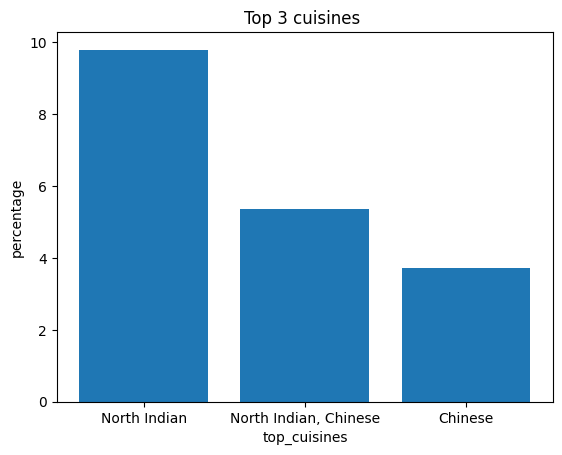

In [13]:
# first go in the table then select the target column which is cuisines

df['Cuisines']

# now will count the repeatd values
no_of_uniquevalues=df['Cuisines'].value_counts()

# then we will return only top 3 cuisines

top_3_cuisines = no_of_uniquevalues.head(3)
total_resturants = len(df)
percentage = (top_3_cuisines/total_resturants)*100
plt.bar(percentage.index, percentage.values )
plt.xlabel("top_cuisines")
plt.ylabel("percentage")
plt.title("Top 3 cuisines ")
plt.show()

(b) - Calculate the percentage of
restaurants that serve each of the top
cuisines.

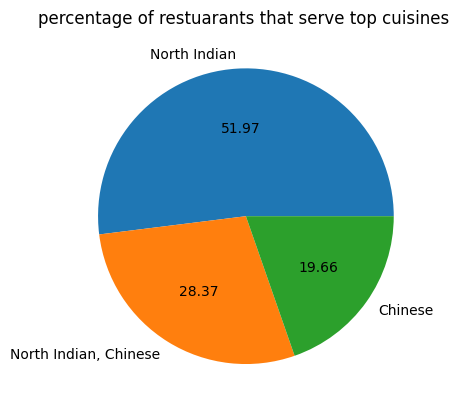

In [14]:
# pie chart which says the %of resturants that serve of the top cuisines
plt.pie(top_3_cuisines, labels= top_3_cuisines.index, autopct="%.2f")
plt.title("percentage of restuarants that serve top cuisines ")
plt.show()

# Task 2 = City Analysis

---



(a) - Identify the city with the highest number
of restaurants in the dataset.

In [15]:
# checked the city names with the resturant counts
top_city = df['City'].value_counts()

# checked the total number of resturants
total_number_of_resturants = len(df)

#calculated the city name with the highest number of resrurants
large_no_of_resturant_wise_city_names = top_city.head(1)

print("the city name which has highest number of resturants is:",large_no_of_resturant_wise_city_names)

the city name which has highest number of resturants is: New Delhi    5473
Name: City, dtype: int64


(b) - Calculate the average rating for
restaurants in each city.

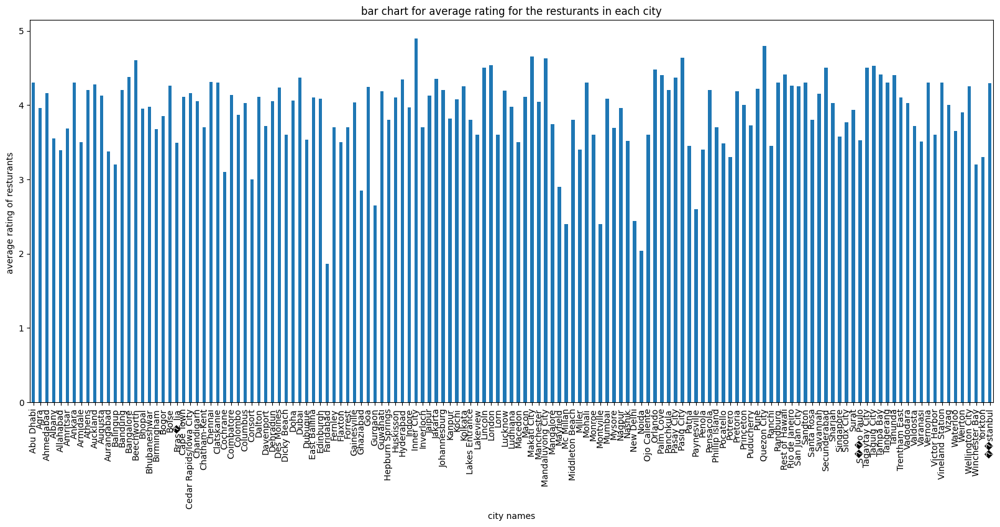

In [16]:
# calculated the average rating city wise
average_rating= df.groupby('City')['Aggregate rating'].mean()
average_rating.plot(kind= 'bar',figsize=(20,8))
plt.xlabel("city names")
plt.ylabel("average rating of resturants ")
plt.title("bar chart for average rating for the resturants in each city")
plt.show()


(c) - Determine the city with the highest
average rating.

In [17]:
average_rating = df.groupby('City')['Aggregate rating'].mean()
city_wise_avg_rating = average_rating.idxmax()
highest_avg_rating =average_rating.max()
print("The city with the highest average rating is - ",city_wise_avg_rating , highest_avg_rating)

The city with the highest average rating is -  Inner City 4.9


# Task 3 = Price range distribution

---


(A) - Create a histogram or bar chart to
visualize the distribution of price ranges
among the restaurants.

Text(0.5, 1.0, 'distribution of price range')

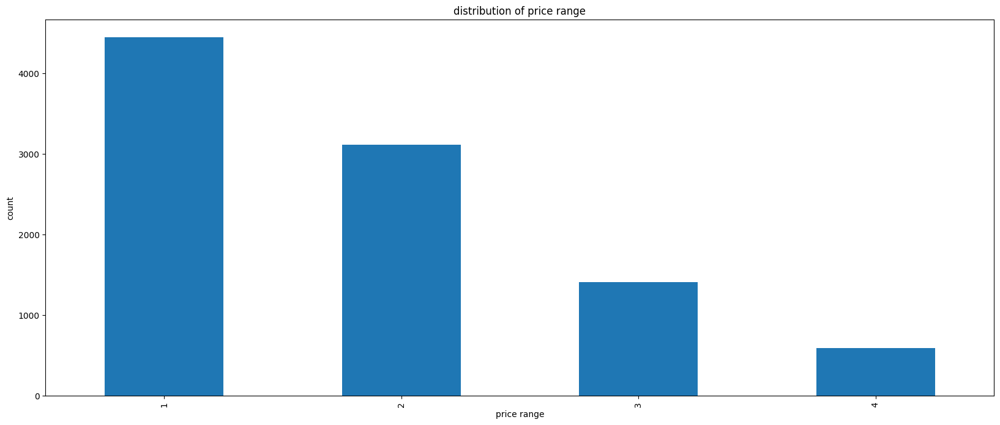

In [18]:
price_range_count= df['Price range'].value_counts().sort_index()
total_resturants = len(df)
percentage_per_price_range= (price_range_count/total_resturants)*100
price_range_count.plot(kind='bar', figsize=(20,8))
plt.xlabel("price range")
plt.ylabel("count")
plt.title("distribution of price range")

(B) - Calculate the percentage of restaurants
in each price range category.

In [19]:
count_price_range= df['Price range'].value_counts()
total_restaurants= len(df)
percentage_of_each_price_range_category= round((count_price_range/total_restaurants)*100)
print(percentage_of_each_price_range_category)

1    47.0
2    33.0
3    15.0
4     6.0
Name: Price range, dtype: float64


#Task 4 = Online Delivery

---


(a)- Determine the percentage of restaurants
that offer online delivery.

In [20]:
count_online_delivery= df['Has Online delivery'].value_counts().get("Yes",0)
percentage_of_restuarants_offer_online_delivery= round((count_online_delivery/total_restaurants)*100)
print("the percentage of restaurants that offer online delivery:-",percentage_of_restuarants_offer_online_delivery)

the percentage of restaurants that offer online delivery:- 26


(b) - Compare the average ratings of restaurants
with and without online delivery.

Average rating of restaurants with online delivery: 3.2488372093023257
Average rating of restaurants without online delivery: 2.465295774647887
Compared the average ratings of restaurants with and without online delivery is : 0.7835414346544387


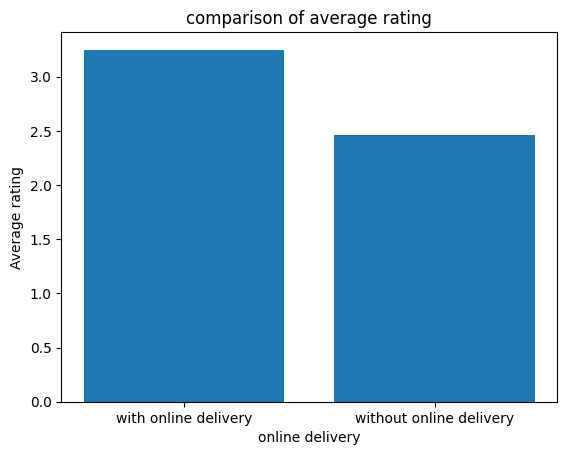

In [21]:
# Average rating of restaurants with online delivery
average_rating_with_online = df[df['Has Online delivery'] == 'Yes']['Aggregate rating'].mean()

# Average rating of restaurants without online delivery
average_rating_without_online = df[df['Has Online delivery'] == 'No']['Aggregate rating'].mean()


print("Average rating of restaurants with online delivery:", average_rating_with_online)
print("Average rating of restaurants without online delivery:", average_rating_without_online)

#now comparision between both is
compare_with_or_without_online_delivery = average_rating_with_online - average_rating_without_online
print("Compared the average ratings of restaurants with and without online delivery is :", compare_with_or_without_online_delivery)
lables= ['with online delivery', 'without online delivery']
average_rating= [average_rating_with_online,average_rating_without_online]
plt.bar(lables, average_rating)
plt.xlabel("online delivery")
plt.ylabel("Average rating")
plt.title("comparison of average rating")
plt.show()


# LEVEL 2

---


# Task 1 =Restaurant Ratings

---


(a) - Analyze the distribution of aggregate
ratings and determine the most common
rating range.

In [22]:
analyze_distribution_of_aggregate_rating = df['Aggregate rating'].value_counts().sort_index()
most_common_rating_range = analyze_distribution_of_aggregate_rating.idxmax()
print("the most common rating range is ",most_common_rating_range)

the most common rating range is  0.0


(b) - Calculate the average number of votes
received by restaurants.

In [23]:
average_number_of_votes= df['Votes'].mean()
print("the average number of votes recieved by resturants is :",average_number_of_votes)

the average number of votes recieved by resturants is : 156.909747670401


# Task 2 = Cuisine Combination

---


 (a)- Identify the most common combinations of
cuisines in the dataset.

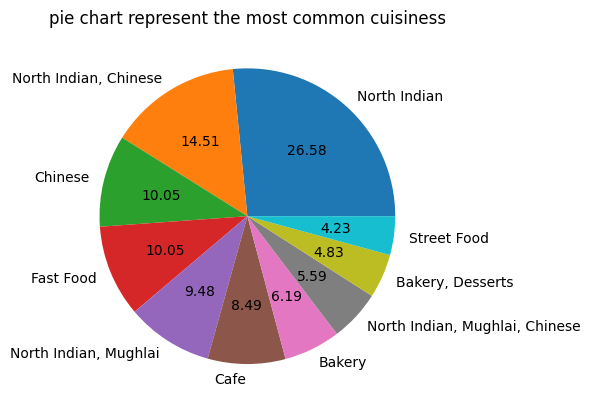

In [24]:
most_common_combination_of_cuisines= df['Cuisines'].value_counts().head(10)

# print(" the most common combinations of cuisines in the dataset.",most_common_combination_of_cuisines)

plt.pie(most_common_combination_of_cuisines,labels= most_common_combination_of_cuisines.index,autopct="%.2f")

plt.title("pie chart represent the most common cuisiness")

plt.show()

(b) -Determine if certain cuisine combinations
tend to have higher ratings.

In [25]:
cuisine_combination_avg_rate = df.groupby('Cuisines')['Aggregate rating'].mean()
avg_rate_of_top10_cuisines= cuisine_combination_avg_rate.nlargest(10)
print("average rating for the top 10 cuisines")
print(avg_rate_of_top10_cuisines)

average rating for the top 10 cuisines
Cuisines
American, BBQ, Sandwich         4.9
American, Burger, Grill         4.9
American, Caribbean, Seafood    4.9
American, Coffee and Tea        4.9
American, Sandwich, Tea         4.9
BBQ, Breakfast, Southern        4.9
Burger, Bar Food, Steak         4.9
Continental, Indian             4.9
European, Asian, Indian         4.9
European, Contemporary          4.9
Name: Aggregate rating, dtype: float64


#Task 3= Geographic Analysis

---


Plot the locations of restaurants on a
map using longitude and latitude
coordinates.

Identify any patterns or clusters of
restaurants in specific areas.

In [26]:
!pip install folium

In [27]:
import folium
from IPython.display import display
from sklearn.cluster import KMeans


In [28]:
restaurants_name = df['Restaurant Name']
latitude= df['Latitude']
longitude= df['Longitude']


In [29]:
X= df[["Latitude", 'Longitude']]
num_cluster = 5


In [30]:
kmeans= KMeans(num_cluster, random_state= 42)

df['Cluster']= kmeans.fit_predict(X)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [31]:
map_center =[latitude.mean(),longitude.mean()]
resturant_map = folium.Map(location= map_center, zoom_start=12)

In [32]:
cluster_colour= ['red','blue','green', 'purple', 'orange']


In [33]:
for index,row in df.iterrows():
  restaurants_name= row["Restaurant Name"]
  latitude = row["Latitude"]
  longitude= row['Longitude']
  cuisines = row['Cuisines']
  rating = row['Aggregate rating']
  cluster = row['Cluster']
  popular_text = f'Resturant: {restaurants_name}\n cuisiness:{cuisines}\n Rating:{rating}'
  marker = folium.Marker([latitude, longitude],popular_text)
  marker.add_to(resturant_map)
  display(resturant_map)

KeyboardInterrupt: 

#Task 4 = Task: Restaurant Chains

---



Identify if there are any restaurant chains
present in the dataset.

Analyze the ratings and popularity of
different restaurant chains.

In [34]:
resturant_chains = df.groupby('Restaurant Name').size().reset_index(name="Chain Count")
resturant_chains= resturant_chains[resturant_chains['Chain Count']>1]
resturant_chains = resturant_chains.sort_values(by = "Chain Count", ascending= False)

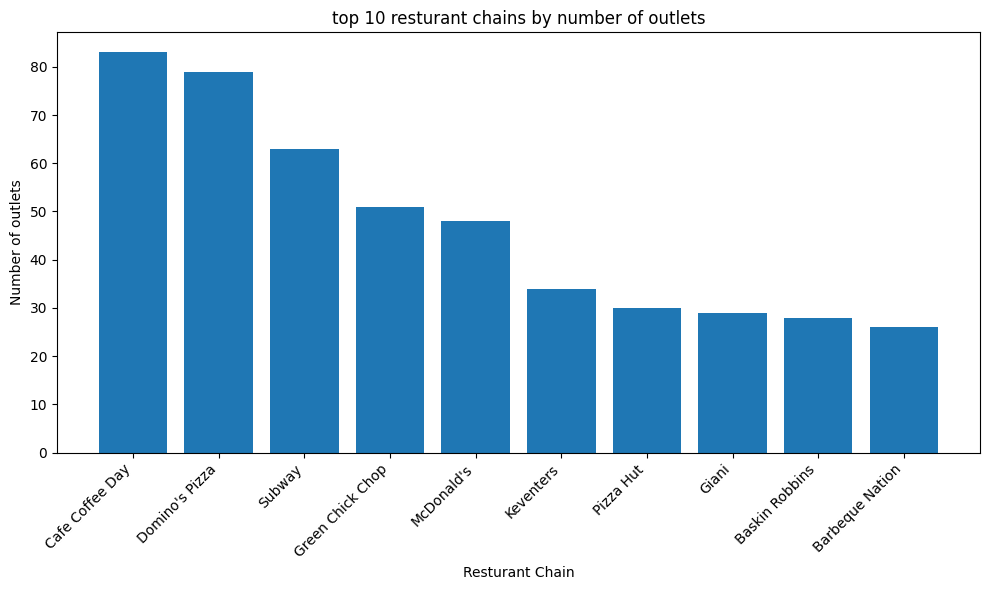

In [35]:
plt.figure(figsize= (10,6))
plt.bar(resturant_chains['Restaurant Name'][:10], resturant_chains['Chain Count'][:10])
plt.xticks(rotation=45,ha='right')
plt.xlabel("Resturant Chain")
plt.ylabel("Number of outlets")
plt.title("top 10 resturant chains by number of outlets")
plt.tight_layout()
plt.show()

In [36]:
chain_rating = df.groupby('Restaurant Name')['Aggregate rating'].mean().reset_index(name="Average Rating")
chain_votes= df.groupby('Restaurant Name')['Votes'].sum().reset_index(name="Total Votes")


In [37]:
chain_analysis= pd.merge(chain_rating, chain_votes , on ="Restaurant Name")
chain_analysis= chain_analysis.sort_values(by= "Average Rating", ascending= False)

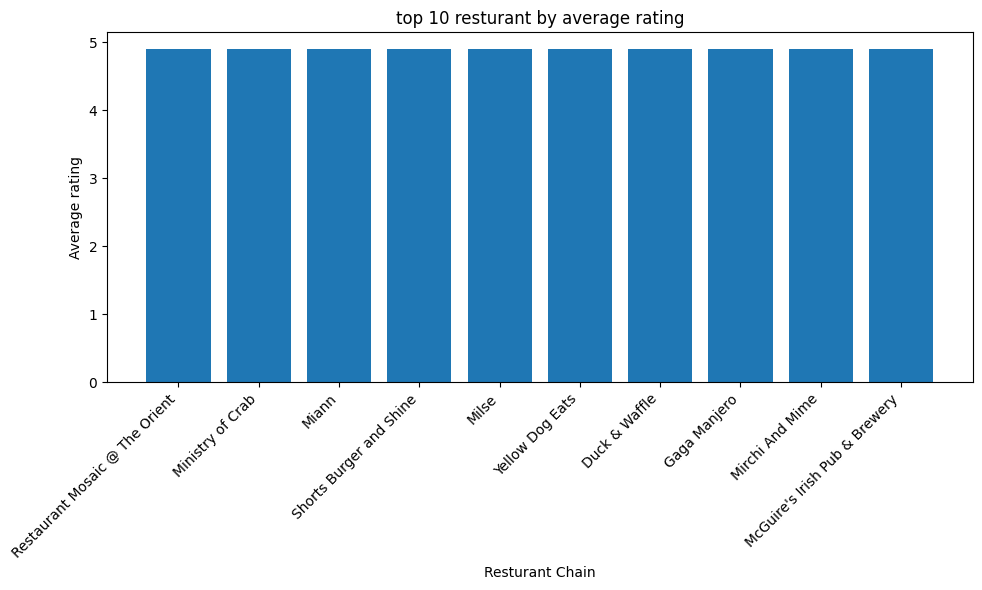

In [38]:
plt.figure(figsize= (10,6))
plt.bar(chain_analysis['Restaurant Name'][:10], chain_analysis['Average Rating'][:10])
plt.xticks(rotation=45,ha='right')
plt.xlabel("Resturant Chain")
plt.ylabel("Average rating")
plt.title("top 10 resturant by average rating")
plt.tight_layout()
plt.show()

# LEVEL 3


---
#TASK 1 Restaurant Reviews

Analyze the text reviews to identify the most
common positive and negative keywords.

Calculate the average length of reviews and
explore if there is a relationship between
review length and rating.


In [44]:
! install nltk
import nltk

nltk.download('stopwords')
nltk.download('punkt')

install: missing destination file operand after 'nltk'
Try 'install --help' for more information.


[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [40]:
import pandas as pd
import nltk
from nltk.corpus import stopwords
from nltk.sentiment.vader import SentimentIntensityAnalyzer

In [46]:

reviews = df['Rating text']
nltk.download('vader_lexicon')
df['Review text'] = df['Rating text'].fillna('')
sentiment_analyzer = SentimentIntensityAnalyzer()

[nltk_data] Downloading package vader_lexicon to /root/nltk_data...


In [47]:
def get_sentiment_score(text):
    return sentiment_analyzer.polarity_scores(text)['compound']

df['Sentiment Score'] = reviews.apply(get_sentiment_score)
df['Sentiment'] = df['Sentiment Score'].apply(lambda score: 'Positive' if score >= 0 else 'Negative')

In [48]:
positive_keywords = {}
negative_keywords = {}

stop_words = set(stopwords.words('english'))

for index, row in df.iterrows():
    words = nltk.word_tokenize(row['Review text'].lower())
    filtered_words = [word for word in words if word.isalpha() and word not in stop_words]

    for word in filtered_words:
        if row['Sentiment'] == 'Positive':
            positive_keywords[word] = positive_keywords.get(word, 0) + 1
        else:
            negative_keywords[word] = negative_keywords.get(word, 0) + 1

In [49]:
top_positive_keywords = dict(sorted(positive_keywords.items(), key=lambda item: item[1], reverse=True)[:10])
top_negative_keywords = dict(sorted(negative_keywords.items(), key=lambda item: item[1], reverse=True)[:10])


print("Top 10 Positive Keywords:", top_positive_keywords)
print("Top 10 Negative Keywords:", top_negative_keywords)

Top 10 Positive Keywords: {'average': 3737, 'good': 3179, 'rated': 2148, 'excellent': 301}
Top 10 Negative Keywords: {'poor': 186}


In [50]:
df['Review Length'] = df['Review text'].apply(lambda x: len(nltk.word_tokenize(x)))
average_review_length = df['Review Length'].mean()

Average Review Length: 1.3378703800649148


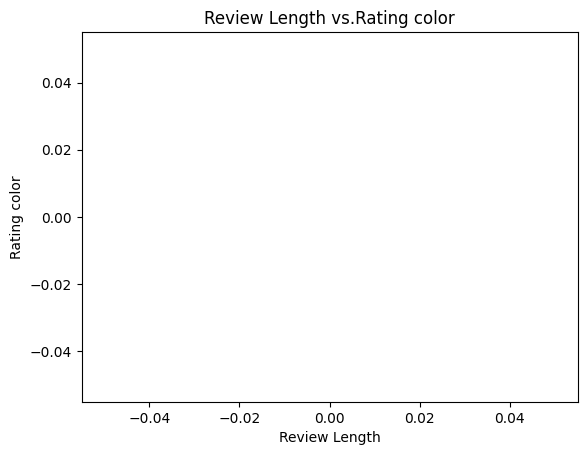

In [51]:
print("Average Review Length:", average_review_length)
df['Rating color'] = pd.to_numeric(df['Rating color'], errors='coerce')
average_length_by_rating = df.groupby('Rating color')['Review Length'].mean()
plt.scatter(df['Review Length'], df['Rating color'])
plt.xlabel('Review Length')
plt.ylabel('Rating color')
plt.title('Review Length vs.Rating color')
plt.show()


In [52]:
correlation_coefficient = df['Review Length'].corr(df['Rating color'])
print("Correlation Coefficient between Review Length and Rating color:", correlation_coefficient)

Correlation Coefficient between Review Length and Rating color: nan


#TASK 2

---

Votes Analysis

Identify the restaurants with the highest and
lowest number of votes.

Analyze if there is a correlation between the
number of votes and the rating of a
restaurant.

In [53]:
restaurant_with_highest_votes = df.loc[df["Votes"].idxmax()]
restaurant_with_lowest_votes = df.loc[df["Votes"].idxmin()]
print("Restaurant with the highest number of votes:")
print(restaurant_with_highest_votes)

Restaurant with the highest number of votes:
Restaurant ID                                                       51705
Restaurant Name                                                      Toit
Country Code                                                            1
City                                                            Bangalore
Address                 298, Namma Metro Pillar 62, 100 Feet Road, Ind...
Locality                                                      Indiranagar
Locality Verbose                                   Indiranagar, Bangalore
Longitude                                                       77.640709
Latitude                                                        12.979166
Cuisines                                         Italian, American, Pizza
Average Cost for two                                                 2000
Currency                                               Indian Rupees(Rs.)
Has Table booking                                                  

In [54]:
print("\nRestaurant with the lowest number of votes:")
print(restaurant_with_lowest_votes)


Restaurant with the lowest number of votes:
Restaurant ID                                                     6710645
Restaurant Name                                          Cantinho da Gula
Country Code                                                           30
City                                                           S��o Paulo
Address                 Rua Pedroso Alvarenga, 522, Itaim Bibi, S��o P...
Locality                                                       Itaim Bibi
Locality Verbose                                   Itaim Bibi, S��o Paulo
Longitude                                                      -46.675667
Latitude                                                          -23.581
Cuisines                                                        Brazilian
Average Cost for two                                                   55
Currency                                               Brazilian Real(R$)
Has Table booking                                                  

In [55]:
df["Votes"] = pd.to_numeric(df["Votes"])
df["Aggregate rating"] = pd.to_numeric(df["Aggregate rating"])
correlation = df["Votes"].corr(df["Aggregate rating"])
print("\nCorrelation between number of votes and rating:", correlation)


Correlation between number of votes and rating: 0.31369058419541157


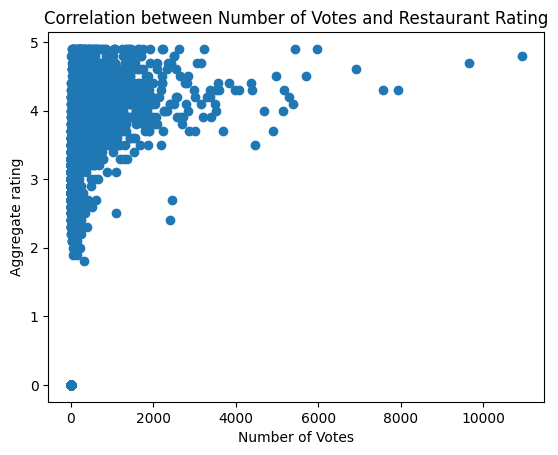

In [57]:
plt.scatter(df["Votes"], df["Aggregate rating"])
plt.xlabel("Number of Votes")
plt.ylabel("Aggregate rating")
plt.title("Correlation between Number of Votes and Restaurant Rating")
plt.show()

# TASK 3

---
Task: Price Range vs. Online Delivery and
Table Booking

Analyze if there is a relationship between the
price range and the availability of online
delivery and table booking.

Determine if higher-priced restaurants are
more likely to offer these services.


In [61]:
price_ranges = df["Price range"].unique()
online_delivery_percentages = []
for price_range in price_ranges:
    restaurants_with_delivery = df[(df["Price range"] == price_range) & (df["Has Online delivery"] == True)]
    total_restaurants = len(df[df["Price range"] == price_range])
    percentage_with_delivery = (len(restaurants_with_delivery) / total_restaurants) * 100
    online_delivery_percentages.append(percentage_with_delivery)
table_booking_percentages = []


In [62]:
for price_range in price_ranges:
    restaurants_with_table_booking = df[(df["Price range"] == price_range) & (df["Has Table booking"] == True)]
    total_restaurants = len(df[df["Price range"] == price_range])
    percentage_with_table_booking = (len(restaurants_with_table_booking) / total_restaurants) * 100
    table_booking_percentages.append(percentage_with_table_booking)

In [63]:
plt.figure(figsize=(10, 5))

<Figure size 1000x500 with 0 Axes>

<Figure size 1000x500 with 0 Axes>

Text(0.5, 1.0, 'Percentage of Restaurants with Online delivery by Price Range')

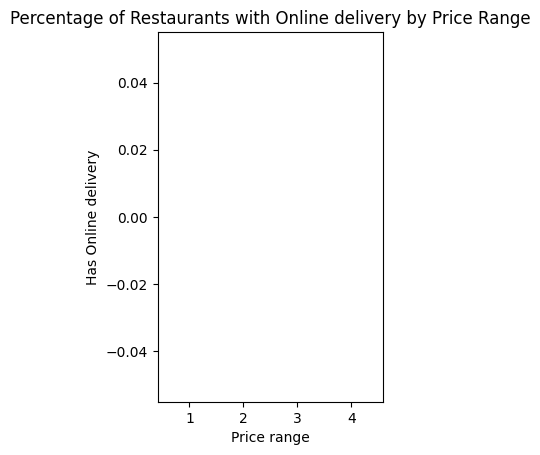

In [64]:
plt.subplot(1, 2, 1)
plt.bar(price_ranges, online_delivery_percentages)
plt.xlabel("Price range")
plt.ylabel("Has Online delivery")
plt.title("Percentage of Restaurants with Online delivery by Price Range")

Text(0.5, 1.0, 'Percentage of Restaurants with Table Booking by Price Range')

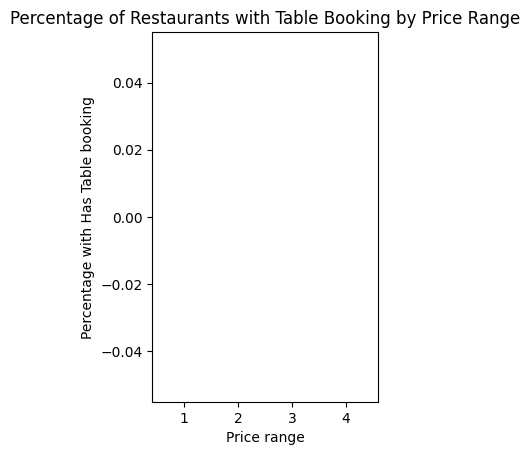

In [65]:
plt.subplot(1, 2, 2)
plt.bar(price_ranges, table_booking_percentages)
plt.xlabel("Price range")
plt.ylabel("Percentage with Has Table booking")
plt.title("Percentage of Restaurants with Table Booking by Price Range")



---

